<a href="https://colab.research.google.com/github/Nidhi2215/HUMAN_DETECTION/blob/main/Video.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab.patches import cv2_imshow

(288, 384, 3)


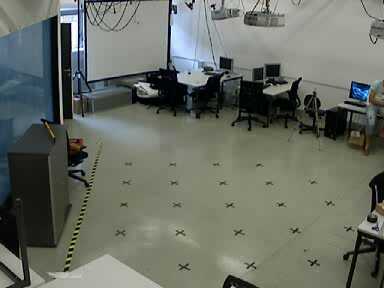

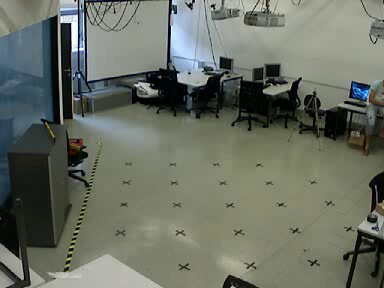

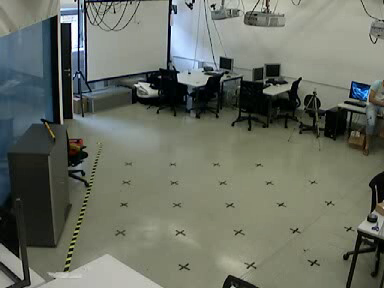

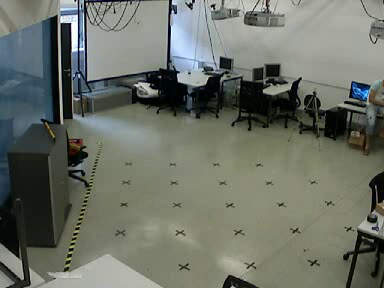

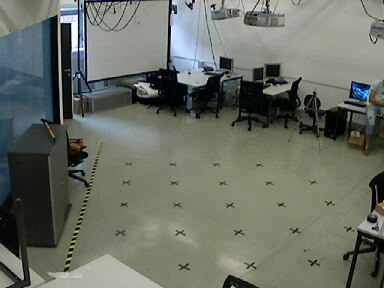

...

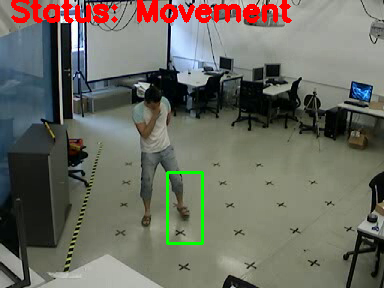

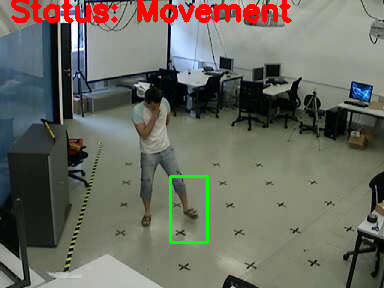

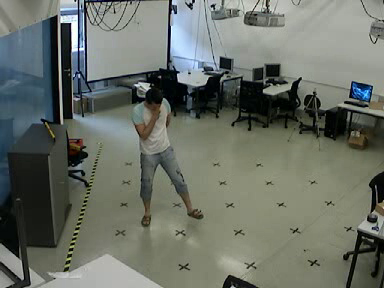

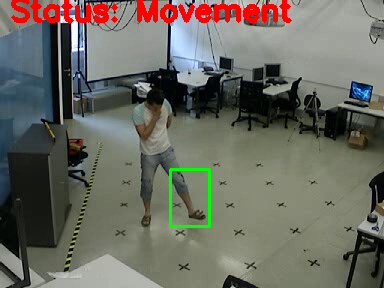

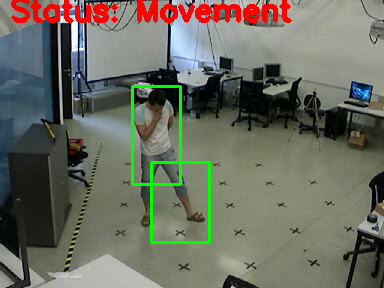

Buffered data was truncated after reaching the output size limit.

In [ ]:
import cv2
import numpy as np

cap = cv2.VideoCapture('/content/video.avi')   #path to the video and cap indicates the VideoCapture() object.
frame_width = int( cap.get(cv2.CAP_PROP_FRAME_WIDTH))  #this will get the width of the video frame and then convert it to int datatype.

frame_height =int( cap.get( cv2.CAP_PROP_FRAME_HEIGHT))    #this will get height in frame_height variable.

fourcc = cv2.VideoWriter_fourcc('X','V','I','D')    #this specifies the video codec i.e. hardware/software to compress or decompress a video.
          
out = cv2.VideoWriter("output.avi", fourcc, 5.0, (1280,720))     

'''


'''
ret, frame1 = cap.read()    #we can read a frame using cap.read() which returns frame and status for next frame which is false in the end of the video.
ret, frame2 = cap.read()
print(frame1.shape)
while cap.isOpened():   #cap.isOpened function is used to return true or false based on whether or not cap object has started capturing the frames.
    diff = cv2.absdiff(frame1, frame2)    #absolute difference at each pixel
    gray = cv2.cvtColor(diff, cv2.COLOR_BGR2GRAY)  #to convert color from BGR to Gray scale
    blur = cv2.GaussianBlur(gray, (5,5), 0) #to mute the noise gaussian blur is used.
    _, thresh = cv2.threshold(blur, 20, 255, cv2.THRESH_BINARY)  
    dilated = cv2.dilate(thresh, None, iterations=3)  #to remove white  noise.
    contours, _ = cv2.findContours(dilated, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)     #to extract contours(points of same intensity) from the image. 

    for contour in contours:
        (x, y, w, h) = cv2.boundingRect(contour)   #draws bounding box around the contour

        if cv2.contourArea(contour) < 900:   #if contour area is leass than 900 ignore that iteration and move onto the next iteration.
            continue
        cv2.rectangle(frame1, (x, y), (x+w, y+h), (0, 255, 0), 2)
        cv2.putText(frame1, "Status: {}".format('Movement'), (10, 20), cv2.FONT_HERSHEY_SIMPLEX,
                    1, (0, 0, 255), 3)     #to draw text string onto the frame .Also for movement tracking.
  
                  
    image = cv2.resize(frame1, (1280,720))
    out.write(image) 
    cv2_imshow(frame1)   #show 
    frame1 = frame2
    ret, frame2 = cap.read()

    if cv2.waitKey(40) == 27:    #display a window for given milliseconds or until any key is pressed.
        break

cv2.destroyAllWindows()
cap.release()  #closes input video file
out.release()  